<a href="https://colab.research.google.com/github/AnaFerreira015/dip-2024-2/blob/main/Task_Color_Image_Processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 1. Display Color Histograms for RGB Images

Objective: Calculate and display separate histograms for the R, G, and B channels of a color image.

Topics: Color histograms, channel separation.

Challenge: Compare histograms of different images (e.g., nature vs. synthetic images).

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os
from google.colab import files
from PIL import Image

In [2]:
image_files = [
    "baboon.png",
    "chips.png",
    "lena.png",
    "rgb.png",
    "rgbcube_kBKG.png",
    "flowers.jpg",
    "hsv_disk.png",
    "monkey.jpeg",
    "strawberries.tif"
]

In [3]:
def plot_rgb_histograms(image, title):
    rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    r, g, b = cv2.split(rgb)

    hist_r = cv2.calcHist([r], [0], None, [256], [0, 256])
    hist_g = cv2.calcHist([g], [0], None, [256], [0, 256])
    hist_b = cv2.calcHist([b], [0], None, [256], [0, 256])

    plt.figure(figsize=(10, 4))
    plt.title(f"Histograma RGB - {title}")
    plt.xlabel("Intensidade de pixel")
    plt.ylabel("Número de pixels")
    plt.plot(hist_r, label='Vermelho', color='red')
    plt.plot(hist_g, label='Verde', color='green')
    plt.plot(hist_b, label='Azul', color='blue')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [12]:
uploaded = files.upload()

Saving baboon.png to baboon.png


In [13]:
base_path = "/content/"

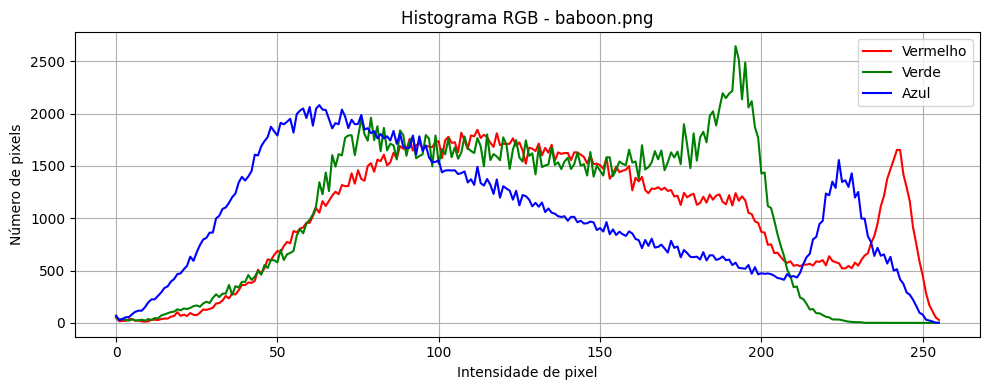

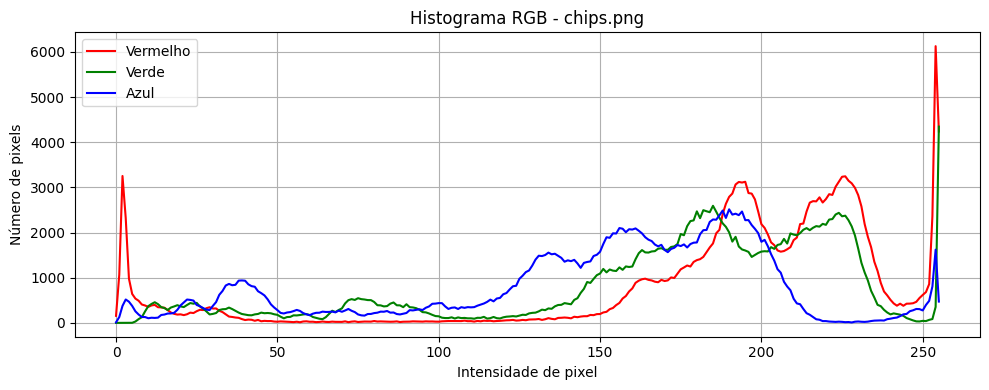

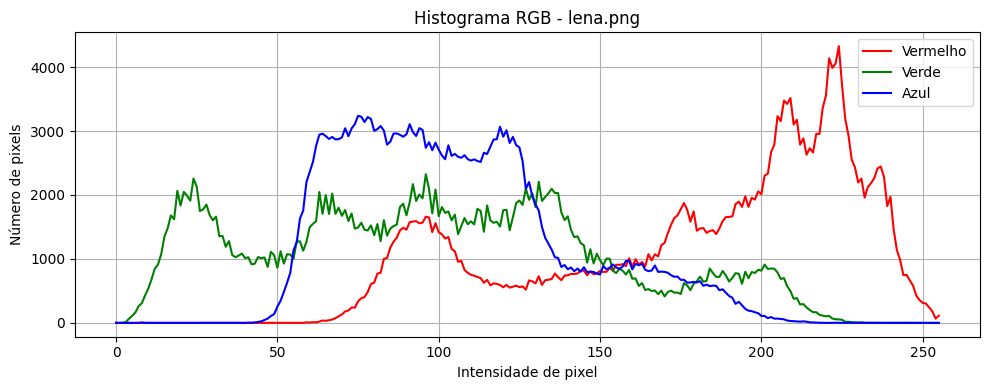

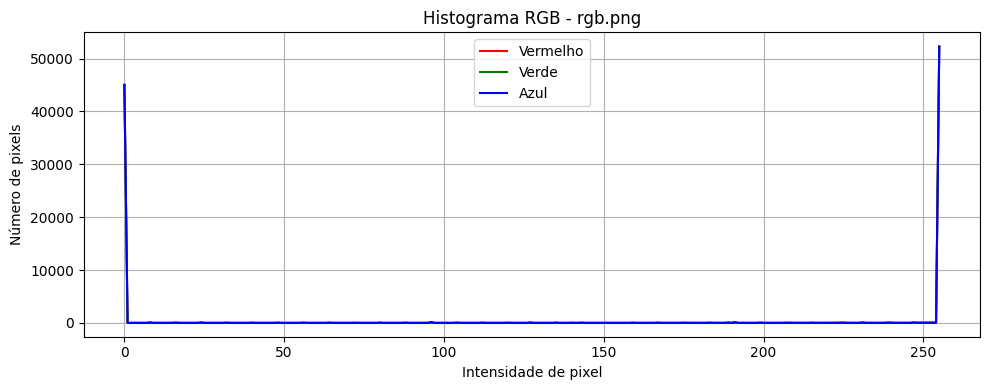

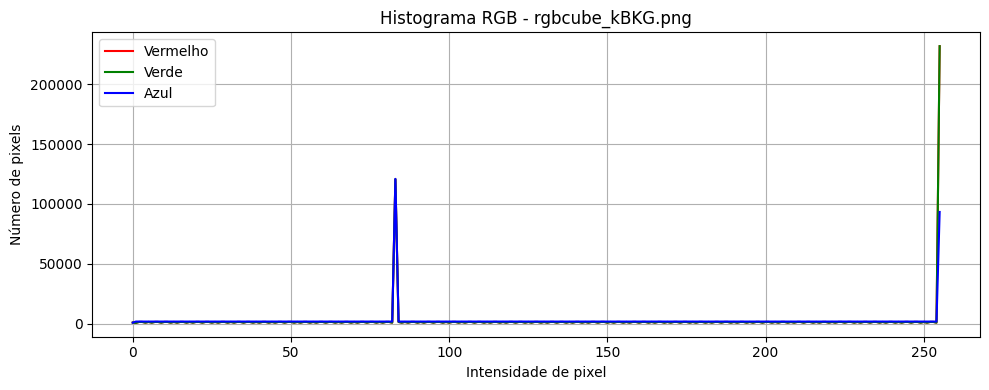

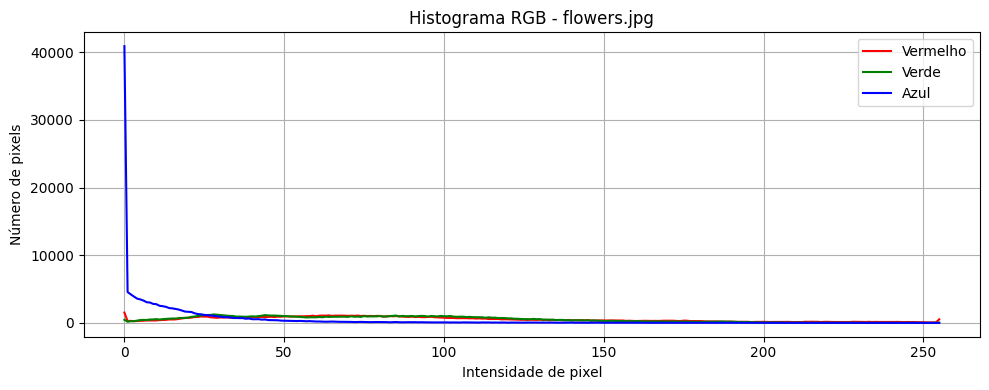

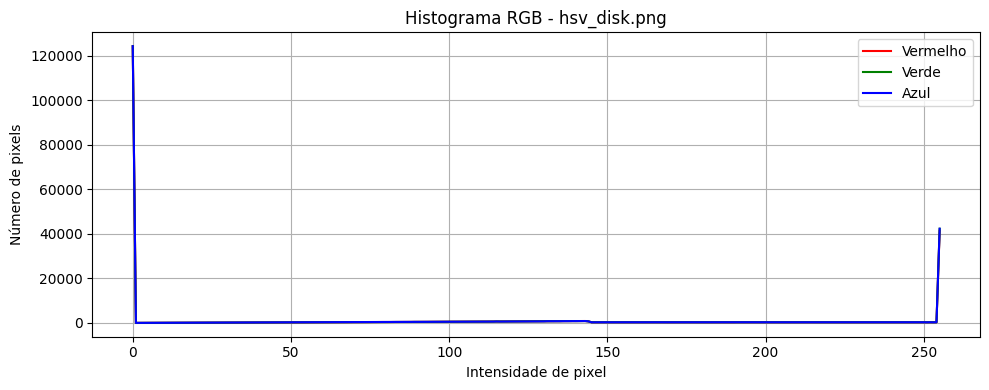

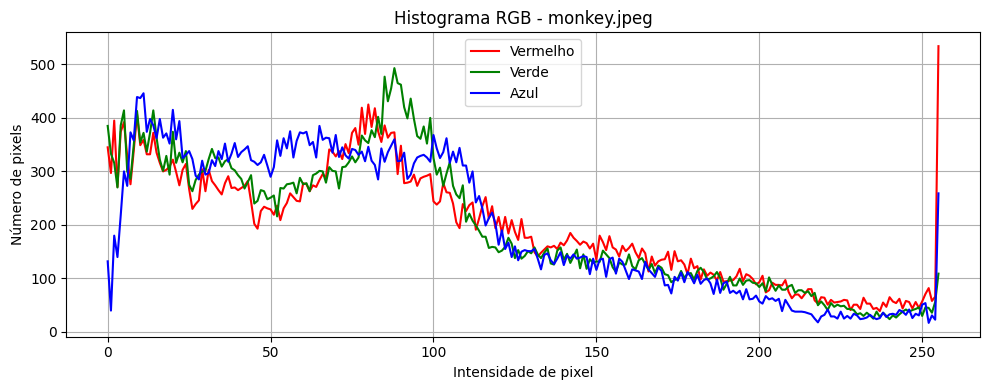

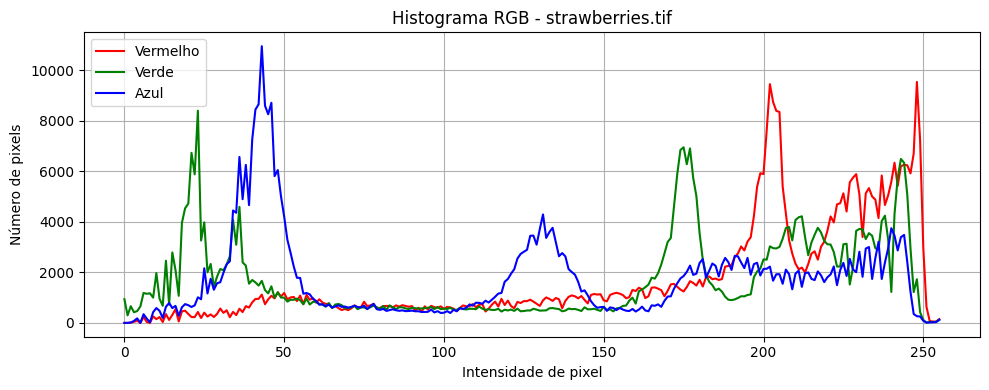

In [14]:
for file_name in image_files:
    path = os.path.join(base_path, file_name)
    if os.path.exists(path):
        img = cv2.imread(path)
        plot_rgb_histograms(img, file_name)
    else:
        print(f"Arquivo {file_name} não encontrado no caminho {path}.")

Ao comparar as imagens naturais, como baboon.png, com imagens sintéticas, como rgb.png, observa-se que os histogramas das imagens naturais apresentam distribuições amplas e irregulares, com tonalidades variadas. Já as imagens sintéticas possuem histogramas com picos bem definidos, muitas vezes concentrados em poucos níveis de intensidade, refletindo o uso de cores puras e padrões artificiais. Essa diferença é esperada, já que imagens naturais possuem maior complexidade de cor e textura.

In [15]:
synthetic_image_path = "/content/rgb.png"
synthetic_image = cv2.imread(synthetic_image_path)

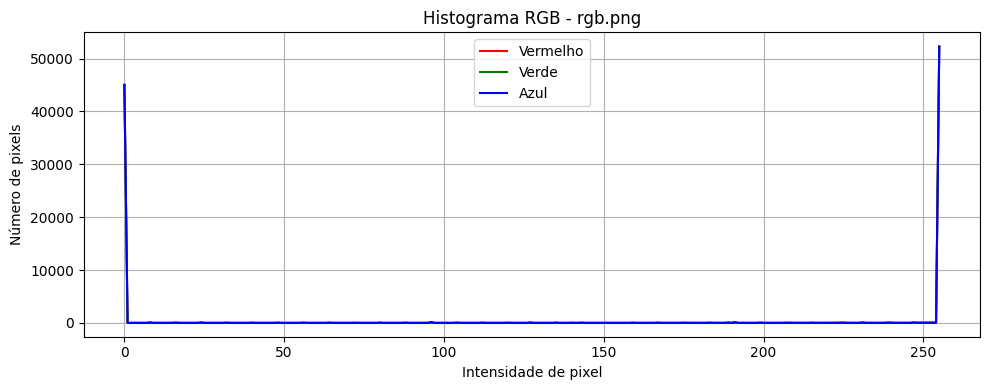

In [16]:
if synthetic_image is not None:
    plot_rgb_histograms(synthetic_image, "rgb.png")
else:
    print("Imagem sintética 'rgb.png' não encontrada.")

A imagem rgb.png, por ser sintética, apresenta histogramas com picos concentrados nos extremos (como 0 e 255), correspondendo a cores puras. Diferentemente de imagens naturais, ela não possui gradações suaves de cor, resultando em histogramas com grandes lacunas e poucos níveis de intensidade ativos. Isso demonstra claramente a diferença entre imagens reais e imagens geradas digitalmente.

## 2. Visualize Individual Color Channels

Objective: Extract and display the Red, Green, and Blue channels of a color image as grayscale and pseudo-colored images.

Topics: Channel separation and visualization.

Bonus: Reconstruct the original image using the separated channels.

In [17]:
def visualize_channels(image, title):
    rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    r, g, b = cv2.split(rgb)

    plt.figure(figsize=(12, 6))
    plt.suptitle(f"Canais separados - {title}", fontsize=16)

    plt.subplot(2, 4, 1)
    plt.imshow(r, cmap='gray')
    plt.title("Vermelho (Gray)")
    plt.axis('off')

    plt.subplot(2, 4, 2)
    plt.imshow(g, cmap='gray')
    plt.title("Verde (Gray)")
    plt.axis('off')

    plt.subplot(2, 4, 3)
    plt.imshow(b, cmap='gray')
    plt.title("Azul (Gray)")
    plt.axis('off')

    r_color = np.zeros_like(rgb)
    r_color[:, :, 0] = r

    g_color = np.zeros_like(rgb)
    g_color[:, :, 1] = g

    b_color = np.zeros_like(rgb)
    b_color[:, :, 2] = b

    plt.subplot(2, 4, 5)
    plt.imshow(r_color)
    plt.title("Vermelho (Colorido)")
    plt.axis('off')

    plt.subplot(2, 4, 6)
    plt.imshow(g_color)
    plt.title("Verde (Colorido)")
    plt.axis('off')

    plt.subplot(2, 4, 7)
    plt.imshow(b_color)
    plt.title("Azul (Colorido)")
    plt.axis('off')

    reconstructed = cv2.merge([r, g, b])
    plt.subplot(2, 4, 8)
    plt.imshow(reconstructed)
    plt.title("Imagem Reconstruída")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

In [18]:
images_to_test = [
    "/content/lena.png",
    "/content/baboon.png",
    "/content/rgb.png"
]

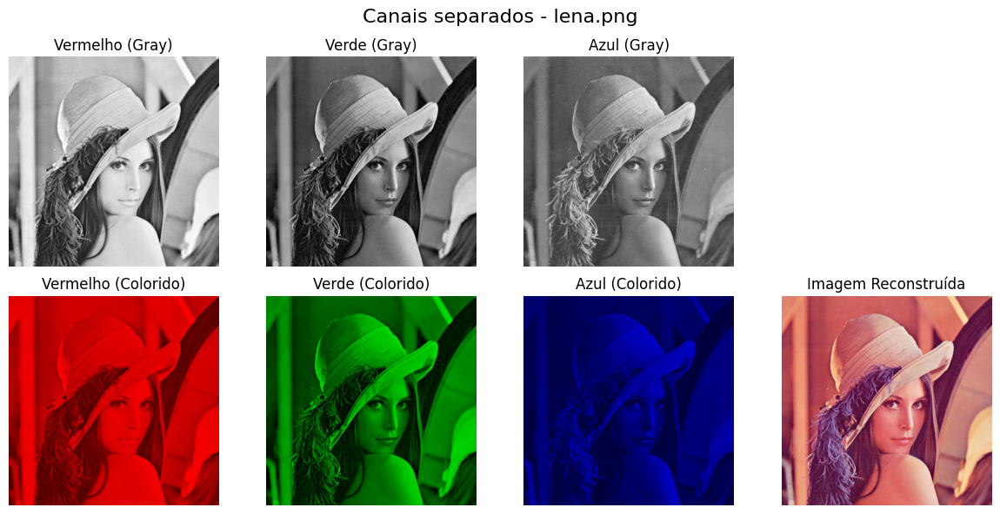

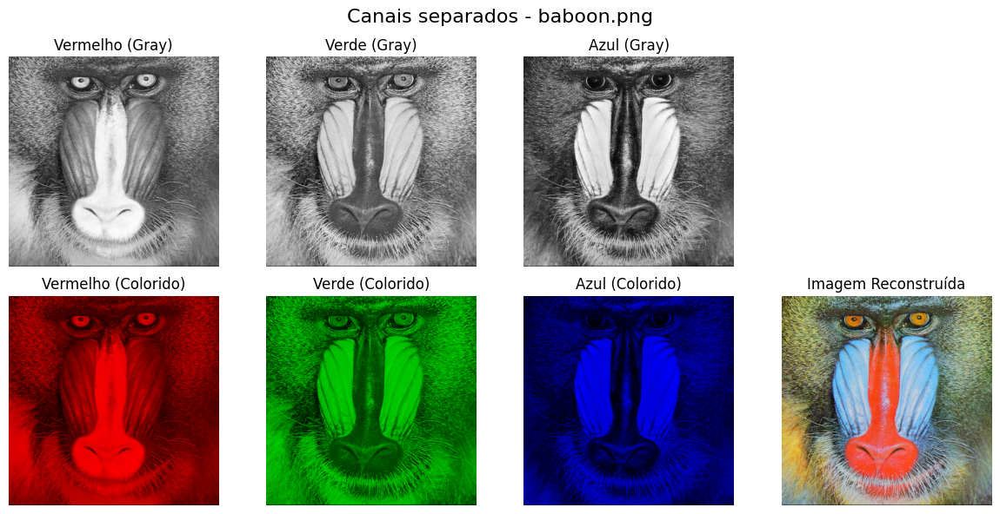

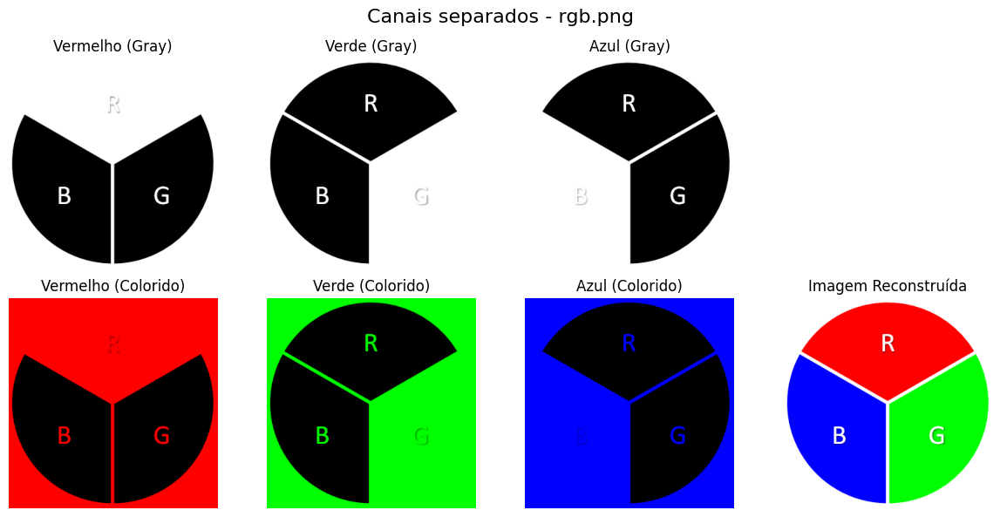

In [19]:
for img_path in images_to_test:
    img = cv2.imread(img_path)
    if img is not None:
        visualize_channels(img, os.path.basename(img_path))
    else:
        print(f"Imagem não encontrada: {img_path}")

Nesta questão, foram extraídos e visualizados os canais vermelho (R), verde (G) e azul (B) das imagens lena.png, baboon.png e rgb.png. Cada canal foi exibido em tons de cinza (representando a intensidade da cor) e também em pseudo-cor (onde apenas o canal correspondente é mantido e os outros são zerados).

A imagem lena.png apresenta uma distribuição suave entre os três canais, com todos contribuindo significativamente para a composição final. Os tons em cinza mostram claramente as variações de luz, enquanto as imagens pseudo-coloridas evidenciam a presença equilibrada de vermelho, verde e azul.

Já a imagem baboon.png, por ser uma fotografia com cores mais saturadas, mostra diferenças mais acentuadas entre os canais. O canal vermelho domina nas áreas centrais do rosto do animal, o azul destaca as regiões ao redor do nariz e dos olhos, e o verde contribui para os detalhes da pelagem.

Por fim, a imagem rgb.png, uma composição sintética com cores puras, apresenta canais extremamente segmentados: cada canal aparece apenas nas áreas correspondentes, com valores máximos (255) e o restante completamente preto (0). Isso resulta em histogramas e visualizações onde os canais são independentes e não há transição entre tons.

A imagem reconstruída, em todos os casos, se mostrou fiel à original, evidenciando que a separação e recombinação dos canais foi realizada corretamente.

## 3. Convert Between Color Spaces (RGB ↔ HSV, LAB, YCrCb, CMYK)

Objective: Convert an RGB image to other color spaces and display the result.

Topics: Color space conversion.

Challenge: Display individual channels from each converted space.

In [20]:
def show_color_space_channels(image, title_prefix, color_space_name, cmap='gray'):
    channels = cv2.split(image)
    plt.figure(figsize=(12, 4))
    plt.suptitle(f"{color_space_name} - {title_prefix}", fontsize=14)

    for i, channel in enumerate(channels):
        plt.subplot(1, len(channels), i + 1)
        plt.imshow(channel, cmap=cmap)
        plt.title(f"{color_space_name} Canal {i}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

In [21]:
img_path = "/content/lena.png"
bgr_img = cv2.imread(img_path)
rgb_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)

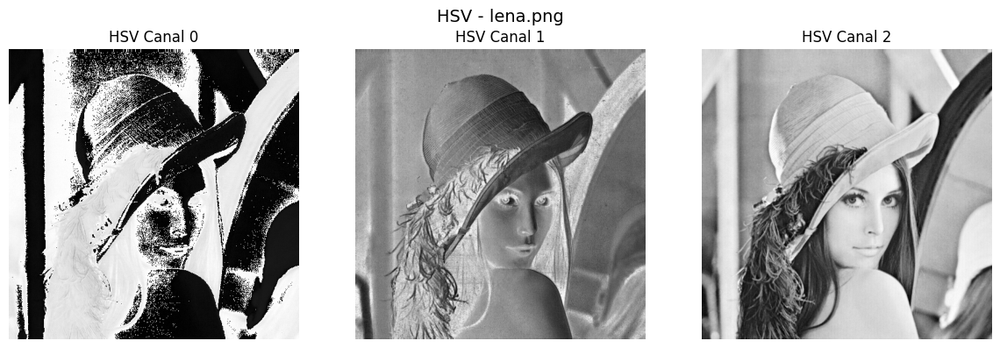

In [22]:
hsv_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2HSV)
show_color_space_channels(hsv_img, "lena.png", "HSV")

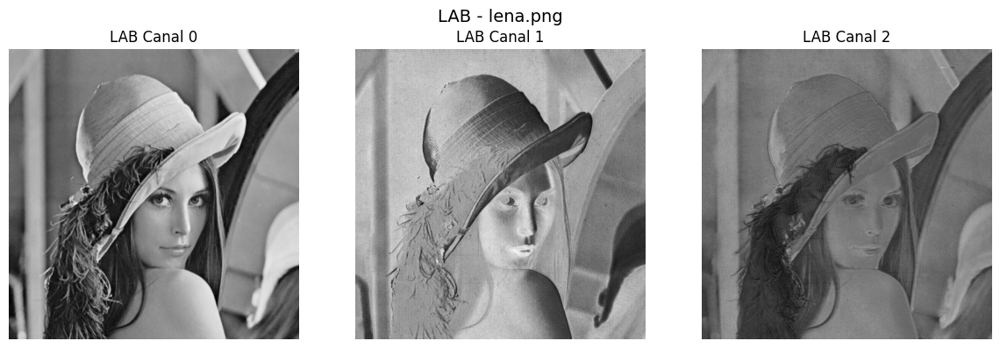

In [23]:
lab_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2LAB)
show_color_space_channels(lab_img, "lena.png", "LAB")

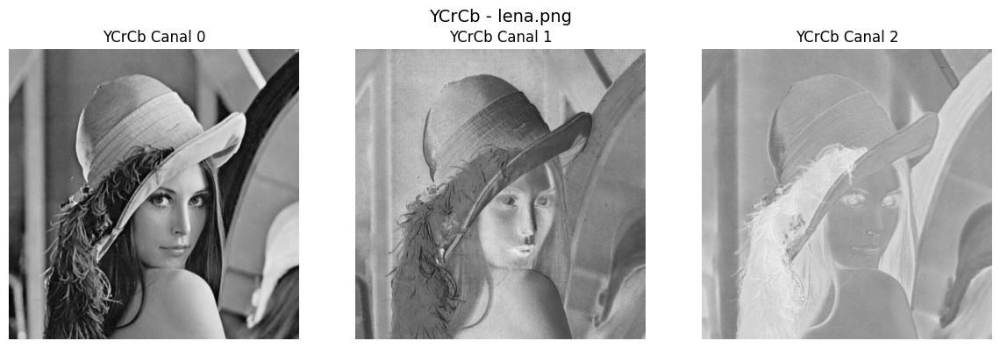

In [24]:
ycrcb_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2YCrCb)
show_color_space_channels(ycrcb_img, "lena.png", "YCrCb")

In [25]:
def convert_rgb_to_cmyk(image_rgb):
    image_rgb = image_rgb.astype(float) / 255
    K = 1 - np.max(image_rgb, axis=2)
    C = (1 - image_rgb[:, :, 0] - K) / (1 - K + 1e-6)
    M = (1 - image_rgb[:, :, 1] - K) / (1 - K + 1e-6)
    Y = (1 - image_rgb[:, :, 2] - K) / (1 - K + 1e-6)

    C = (C * 255).astype(np.uint8)
    M = (M * 255).astype(np.uint8)
    Y = (Y * 255).astype(np.uint8)
    K = (K * 255).astype(np.uint8)

    return C, M, Y, K

In [26]:
C, M, Y, K = convert_rgb_to_cmyk(rgb_img)
plt.figure(figsize=(12, 4))
plt.suptitle("CMYK - lena.png", fontsize=14)

Text(0.5, 0.98, 'CMYK - lena.png')

<Figure size 1200x400 with 0 Axes>

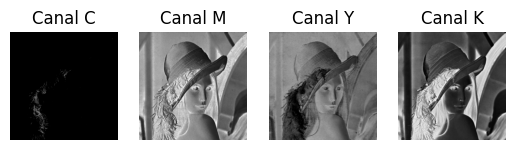

In [27]:
for i, (channel, name) in enumerate(zip([C, M, Y, K], ['C', 'M', 'Y', 'K'])):
    plt.subplot(1, 4, i + 1)
    plt.imshow(channel, cmap='gray')
    plt.title(f"Canal {name}")
    plt.axis('off')

In [28]:
plt.tight_layout()
plt.show()

<Figure size 640x480 with 0 Axes>

Nesta questão, a imagem lena.png foi convertida do espaço RGB para os espaços HSV, LAB, YCrCb e CMYK, e os canais individuais de cada um foram visualizados separadamente.

### HSV (Hue, Saturation, Value)
* Canal 0 (Hue): Representa o tom da cor (matiz). Por ser cíclico,
valores baixos e altos podem parecer semelhantes visualmente. A imagem mostra áreas onde a cor dominante varia bastante, evidenciando regiões com tons quentes ou frios.
* Canal 1 (Saturation): Define a pureza da cor. Regiões com cores mais desbotadas (como pele e fundo) aparecem mais escuras.
* Canal 2 (Value): Indica o brilho (intensidade da luz). Esse canal é muito parecido com uma versão em escala de cinza da imagem original.

### LAB (Luminance, A, B)
* Canal 0 (L): Luminância (intensidade de luz), muito similar a uma imagem em tons de cinza. Ideal para realce de contraste.
* Canal 1 (A): Representa variação entre verde e magenta. A imagem mostra tons médios predominando, com pequenas variações nas áreas mais coloridas.
* Canal 2 (B): Representa variação entre azul e amarelo. Destaca principalmente detalhes nos cabelos e no fundo.

### YCrCb
* Canal Y: Luminância (semelhante ao canal L do LAB), bastante detalhado e útil para compressão de vídeo.
* Canal Cr: Componente cromática vermelha.
* Canal Cb: Componente cromática azul. Ambos mostram informações de cor desacopladas da intensidade, facilitando compressão e manipulação de cor.

### CMYK (Ciano, Magenta, Amarelo, Preto - simulado)
* C, M, Y, K: Calculados a partir do RGB. Mostram como a imagem seria separada em uma impressora, cada canal contendo a "tinta" respectiva.
* O canal K (preto) carrega a maior parte da informação estrutural, enquanto os canais C, M e Y contêm os detalhes das cores.

Cada espaço de cor oferece uma forma única de representar a imagem:
* HSV é útil para segmentação de cores.
* LAB é perceptualmente mais uniforme e útil em tarefas de correção e realce.
* YCrCb é eficiente para compressão (usado em JPEG e vídeo).
* CMYK simula como a imagem seria impressa fisicamente.

A visualização dos canais individuais permite entender melhor como a imagem é codificada em diferentes contextos, revelando informações que podem não estar evidentes no RGB original.

## 4. Compare Effects of Blurring in RGB vs HSV

Objective: Apply Gaussian blur in both RGB and HSV color spaces and compare results.

Topics: Color space effect on filtering.

Discussion: Why HSV might preserve color better in some operations.

In [29]:
def compare_rgb_vs_hsv_blur(img_path):
    bgr_img = cv2.imread(img_path)
    if bgr_img is None:
        print(f"Imagem não encontrada: {img_path}")
        return

    rgb_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)

    rgb_blur = cv2.GaussianBlur(rgb_img, (15, 15), 0)

    hsv_img = cv2.cvtColor(rgb_img, cv2.COLOR_RGB2HSV)
    h, s, v = cv2.split(hsv_img)
    s_blur = cv2.GaussianBlur(s, (15, 15), 0)
    v_blur = cv2.GaussianBlur(v, (15, 15), 0)
    hsv_blur = cv2.merge([h, s_blur, v_blur])
    hsv_to_rgb_blur = cv2.cvtColor(hsv_blur, cv2.COLOR_HSV2RGB)

    plt.figure(figsize=(15, 5))
    plt.suptitle(f"Comparação de Blur: RGB vs HSV - {os.path.basename(img_path)}", fontsize=16)

    plt.subplot(1, 3, 1)
    plt.imshow(rgb_img)
    plt.title("Original (RGB)")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(rgb_blur)
    plt.title("Blur no RGB")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(hsv_to_rgb_blur)
    plt.title("Blur no HSV")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

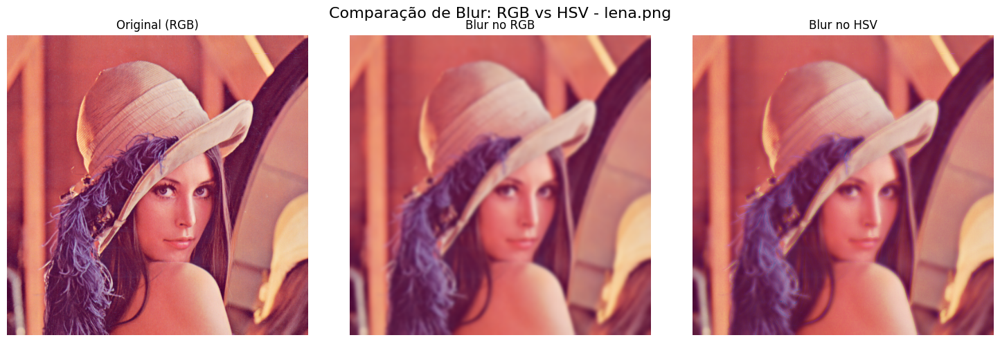

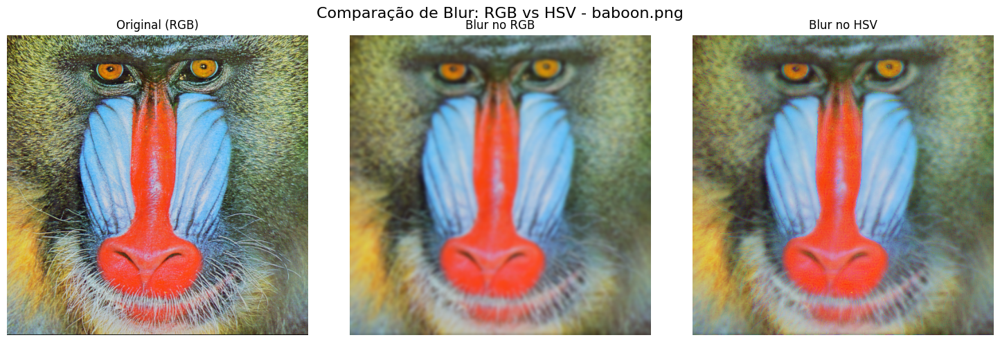

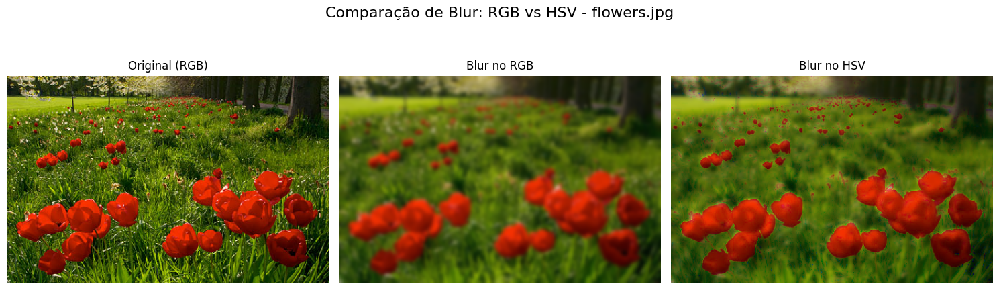

In [30]:
compare_rgb_vs_hsv_blur("/content/lena.png")
compare_rgb_vs_hsv_blur("/content/baboon.png")
compare_rgb_vs_hsv_blur("/content/flowers.jpg")

### Efeitos observados
#### Desfoque em RGB:
* O filtro atua diretamente nos canais de cor (R, G, B);
* Isso pode causar mistura de cores indesejada, criando artefatos ou mudança perceptível no tom original;
* Por exemplo, nas flores vermelhas (flowers.jpg), o blur em RGB "vazou" cor para o fundo verde, distorcendo os limites.

#### Desfoque em HSV:
* Mantivemos o canal H (matiz) fixo e aplicamos o blur apenas nos canais S (saturação) e V (valor);
* O resultado é um desfoque mais natural, que preserva as cores originais;
* A percepção de cor é mais fiel, mesmo nas regiões suavizadas, pois a identidade cromática (matiz) não é alterada.

### Por que HSV preserva melhor a cor?
No espaço HSV, a matiz (H) representa a tonalidade real da cor, enquanto os canais S e V afetam a vivacidade e o brilho. Ao aplicar o filtro apenas nesses dois canais, conseguimos suavizar a imagem sem alterar a cor em si, diferente do RGB onde o desfoque muda diretamente os componentes cromáticos.

Aplicar filtros no espaço HSV permite maior controle sobre o impacto nas cores da imagem. Essa abordagem é especialmente útil em processamento de imagem quando o objetivo é suavizar sem perder fidelidade cromática.

## 5. Apply Edge Detection Filters (Sobel, Laplacian) on Color Images

Objective: Apply Sobel and Laplacian filters on individual channels and on the grayscale version of the image.

Topics: Edge detection, spatial filtering.

Bonus: Merge edge maps from all channels to form a combined result.


In [31]:
def apply_edge_filters(img_path):
    bgr_img = cv2.imread(img_path)
    if bgr_img is None:
        print(f"Imagem não encontrada: {img_path}")
        return

    rgb_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2GRAY)
    r, g, b = cv2.split(rgb_img)

    def sobel_edge(channel):
        sobelx = cv2.Sobel(channel, cv2.CV_64F, 1, 0, ksize=3)
        sobely = cv2.Sobel(channel, cv2.CV_64F, 0, 1, ksize=3)
        sobel = cv2.magnitude(sobelx, sobely)
        return np.uint8(np.clip(sobel, 0, 255))

    def laplacian_edge(channel):
        lap = cv2.Laplacian(channel, cv2.CV_64F)
        return np.uint8(np.clip(np.abs(lap), 0, 255))

    edge_r = sobel_edge(r)
    edge_g = sobel_edge(g)
    edge_b = sobel_edge(b)

    combined_sobel = cv2.merge([edge_r, edge_g, edge_b])

    lap_gray = laplacian_edge(gray)

    plt.figure(figsize=(15, 10))
    plt.suptitle(f"Filtros de Borda - {os.path.basename(img_path)}", fontsize=16)

    plt.subplot(2, 3, 1)
    plt.imshow(rgb_img)
    plt.title("Imagem Original")
    plt.axis('off')

    plt.subplot(2, 3, 2)
    plt.imshow(edge_r, cmap='gray')
    plt.title("Sobel - Canal R")
    plt.axis('off')

    plt.subplot(2, 3, 3)
    plt.imshow(edge_g, cmap='gray')
    plt.title("Sobel - Canal G")
    plt.axis('off')

    plt.subplot(2, 3, 4)
    plt.imshow(edge_b, cmap='gray')
    plt.title("Sobel - Canal B")
    plt.axis('off')

    plt.subplot(2, 3, 5)
    plt.imshow(combined_sobel)
    plt.title("Sobel - Combinação RGB")
    plt.axis('off')

    plt.subplot(2, 3, 6)
    plt.imshow(lap_gray, cmap='gray')
    plt.title("Laplaciano - Escala de Cinza")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

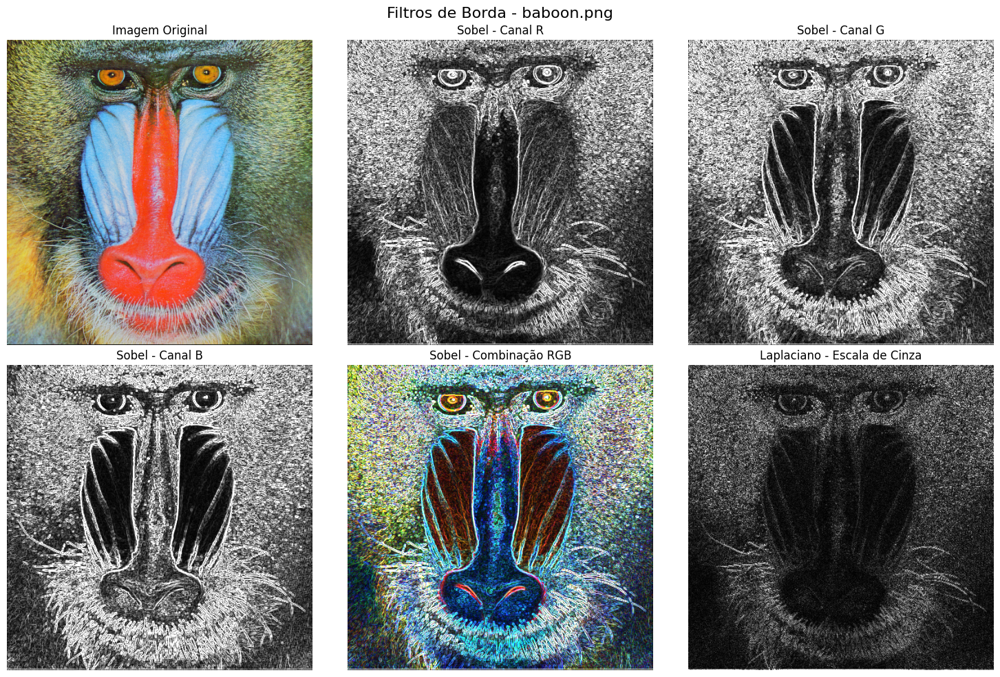

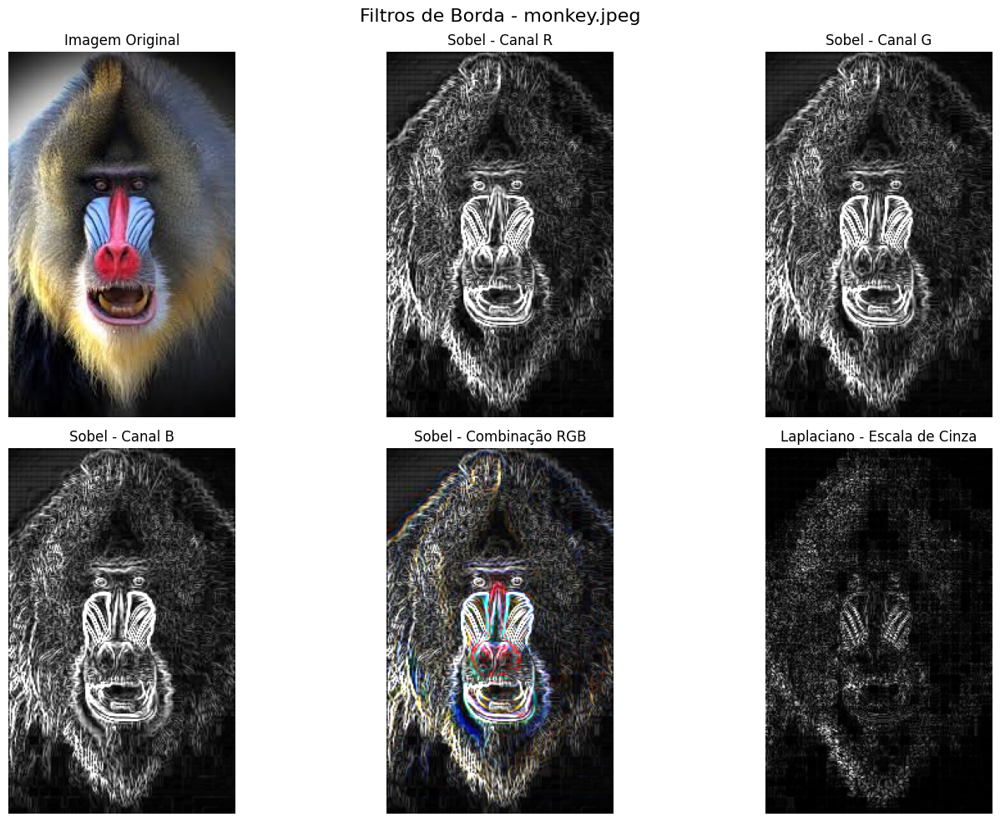

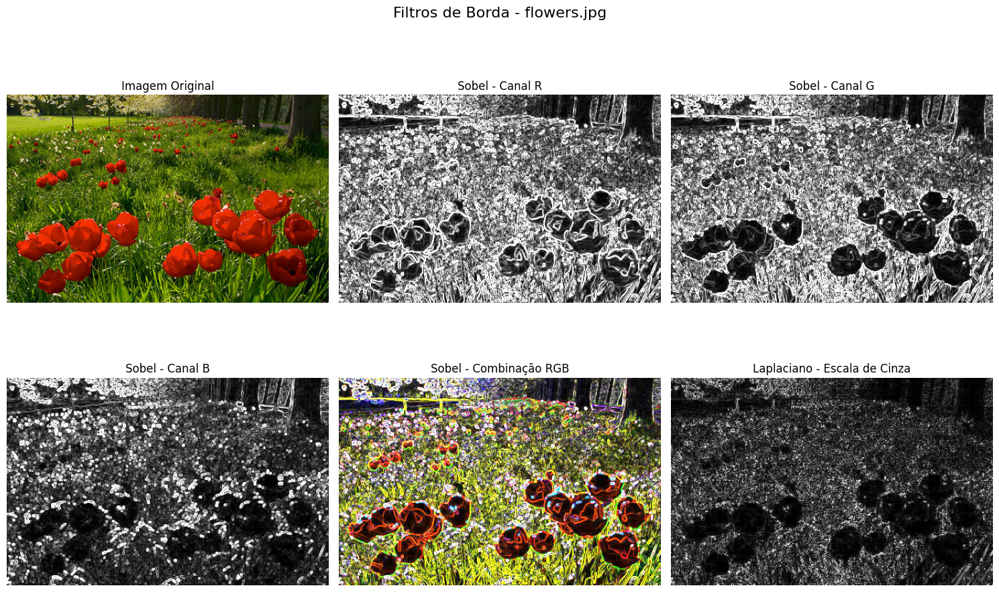

In [32]:
apply_edge_filters("/content/baboon.png")
apply_edge_filters("/content/monkey.jpeg")
apply_edge_filters("/content/flowers.jpg")

Nesta questão, foram aplicados os filtros Sobel e Laplaciano para detectar bordas em imagens coloridas. A abordagem foi feita tanto em cada canal individual (R, G, B) quanto na imagem convertida para tons de cinza.

### Sobel por canal (R, G, B):
* O filtro Sobel evidenciou bordas distintas em cada canal, devido à distribuição única de cor em cada componente.
* Por exemplo, em flowers.jpg, o canal vermelho destacou fortemente os contornos das flores, enquanto o canal verde realçou mais o fundo (gramado).
* Em baboon.png, o canal azul destacou áreas frias como os pelos e sombras, e o vermelho focou nas regiões centrais do rosto.

### Combinação RGB dos mapas de Sobel (Bônus):
* A fusão dos três canais criou uma imagem composta colorida de bordas, representando contribuições variadas das bordas de cada canal.
* Isso fornece um mapa de bordas mais rico visualmente e com informações de cor sobre onde ocorrem as transições de intensidade.

### Laplaciano em escala de cinza:
* O filtro Laplaciano, aplicado à versão em tons de cinza, forneceu um mapa limpo e geral de bordas.
* É útil quando a análise cromática não é necessária, ou para segmentações mais neutras.

A detecção de bordas em imagens coloridas pode ser feita canal a canal para resultados mais específicos, ou combinada para formar uma visão mais completa. O filtro Sobel é ideal para capturar mudanças direcionais, enquanto o Laplaciano fornece um mapa mais uniforme de transições abruptas. A escolha entre canais separados ou tons de cinza depende do tipo de informação que se deseja extrair.

## 6. High-pass and Low-pass Filtering in the Frequency Domain

Objective: Perform DFT on each channel of a color image, apply high-pass and low-pass masks, then reconstruct the image.

Topics: Frequency domain filtering, Fourier Transform.

Tools: cv2.dft(), cv2.idft(), numpy.fft.

In [33]:
def apply_frequency_filter(img_path, radius_low=30, radius_high=5):
    bgr = cv2.imread(img_path)
    if bgr is None:
        print(f"Imagem não encontrada: {img_path}")
        return

    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    channels = cv2.split(rgb)
    shape = rgb.shape[:2]

    def filter_channel(channel, radius, highpass=False):
        dft = cv2.dft(np.float32(channel), flags=cv2.DFT_COMPLEX_OUTPUT)
        dft_shift = np.fft.fftshift(dft)

        rows, cols = channel.shape
        crow, ccol = rows // 2, cols // 2

        mask = np.zeros((rows, cols, 2), np.uint8)
        if highpass:
            mask[:, :] = 1
            cv2.circle(mask, (ccol, crow), radius, (0, 0), -1)
        else:
            cv2.circle(mask, (ccol, crow), radius, (1, 1), -1)

        fshift = dft_shift * mask

        f_ishift = np.fft.ifftshift(fshift)
        img_back = cv2.idft(f_ishift)
        img_back = cv2.magnitude(img_back[:, :, 0], img_back[:, :, 1])

        return cv2.normalize(img_back, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    low_filtered = [filter_channel(c, radius_low, highpass=False) for c in channels]
    high_filtered = [filter_channel(c, radius_high, highpass=True) for c in channels]

    low_img = cv2.merge(low_filtered)
    high_img = cv2.merge(high_filtered)

    plt.figure(figsize=(15, 5))
    plt.suptitle(f"Filtro na Frequência - {os.path.basename(img_path)}", fontsize=16)

    plt.subplot(1, 3, 1)
    plt.imshow(rgb)
    plt.title("Original")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(low_img)
    plt.title("Passa-baixa")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(high_img)
    plt.title("Passa-alta")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

In [34]:
image_paths = [
    "/content/lena.png",
    "/content/baboon.png",
    "/content/flowers.jpg"
]

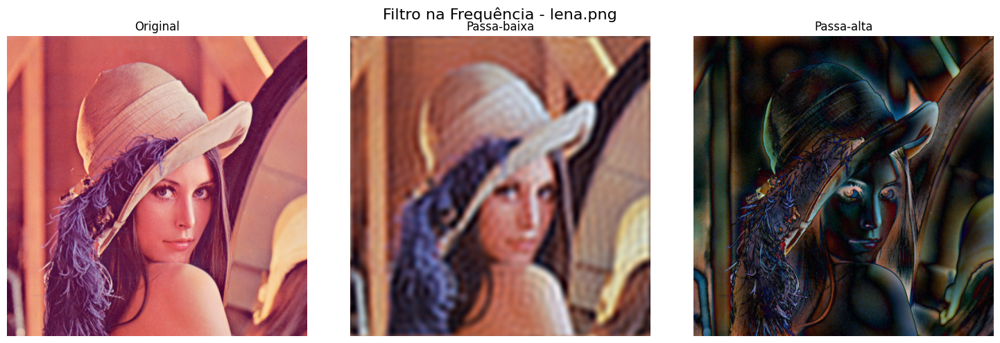

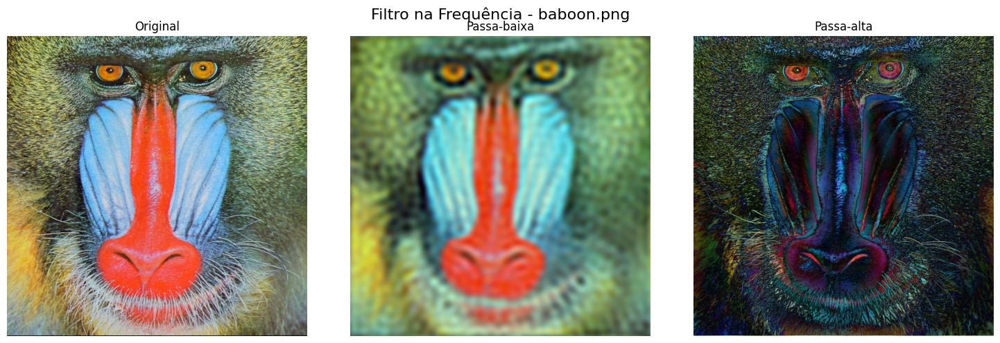

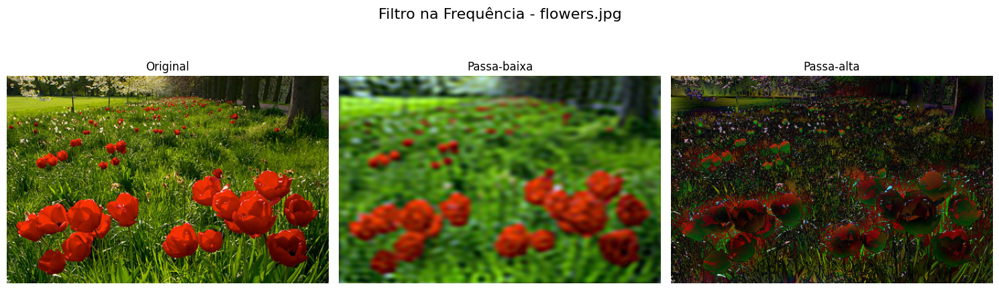

In [35]:
for path in image_paths:
    apply_frequency_filter(path, radius_low=30, radius_high=5)

Nesta questão, aplicamos filtros passa-baixa e passa-alta no domínio da frequência por meio da Transformada Discreta de Fourier (DFT) utilizando cv2.dft() e cv2.idft(). As operações foram realizadas separadamente para os três canais (R, G e B) das imagens.

### Filtro Passa-baixa (Low-pass)
* Objetivo: preservar componentes de baixa frequência (grandes estruturas), removendo detalhes finos e ruídos.

* Resultado visual:

  * A imagem fica borrada, com bordas suaves.
  * Perde-se nitidez, mas mantém-se a forma geral.
  * Em flowers.jpg, as flores e gramado ficam completamente suavizados.
  * Em baboon.png, a textura dos pelos desaparece, restando apenas a forma.

### Filtro Passa-alta (High-pass)
* Objetivo: destacar componentes de alta frequência (bordas e detalhes).

* Resultado visual:
  * A imagem se transforma quase em um mapa de bordas colorido, enfatizando contornos, pelos e texturas.
  * Em lena.png, são realçadas as bordas do chapéu, cabelo e olhos.
  * Em baboon.png, a textura da pele e pelos é evidenciada com grande contraste.
  * Em flowers.jpg, as flores ganham contornos fortes e o fundo se transforma em uma textura rica em detalhes.

O uso da Transformada de Fourier permite manipular seletivamente o conteúdo de uma imagem com base em suas frequências. Filtros passa-baixa são úteis para suavização e remoção de ruído, enquanto os filtros passa-alta são ideais para realce de bordas e detalhes. Aplicar esses filtros separadamente nos canais de cor preserva a fidelidade da reconstrução colorida e permite visualizar a contribuição espectral de cada componente RGB.

## 7. Visualize and Manipulate Bit Planes of Color Images

Objective: Extract bit planes (especially MSB and LSB) from each color channel and display them.

Topics: Bit slicing, data visualization.

Challenge: Reconstruct the image using only the top 4 bits of each channel.


In [36]:
def bit_plane_visualization(img_path):
    bgr = cv2.imread(img_path)
    if bgr is None:
        print(f"Imagem não encontrada: {img_path}")
        return
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    r, g, b = cv2.split(rgb)

    channels = {'R': r, 'G': g, 'B': b}

    for name, channel in channels.items():
        plt.figure(figsize=(12, 4))
        plt.suptitle(f"Bit Planes - Canal {name}", fontsize=16)

        for i in range(8):
            bit_plane = (channel >> i) & 1
            bit_plane_img = np.uint8(bit_plane * 255)
            plt.subplot(2, 4, i + 1)
            plt.imshow(bit_plane_img, cmap='gray')
            plt.title(f"Bit {i}")
            plt.axis('off')

        plt.tight_layout()
        plt.show()

    def reconstruct_from_top_bits(channel):
        result = np.zeros_like(channel, dtype=np.uint8)
        for i in range(4, 8):
            bit_plane = (channel >> i) & 1
            result += (bit_plane << i)
        return result

    r_top = reconstruct_from_top_bits(r)
    g_top = reconstruct_from_top_bits(g)
    b_top = reconstruct_from_top_bits(b)
    reconstructed = cv2.merge([r_top, g_top, b_top])

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(rgb)
    plt.title("Original")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(reconstructed)
    plt.title("Reconstruída (bits 4 a 7)")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

In [37]:
image_paths = [
    "/content/lena.png",
    "/content/baboon.png",
    "/content/rgb.png",
    "/content/flowers.jpg"
]

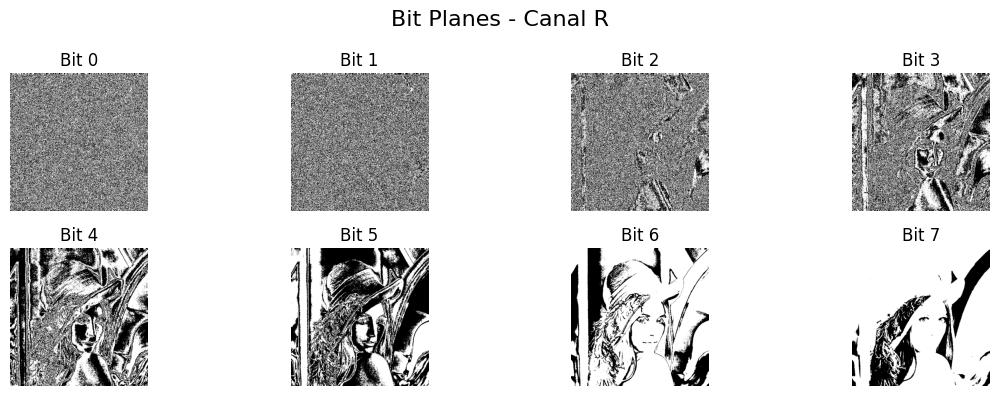

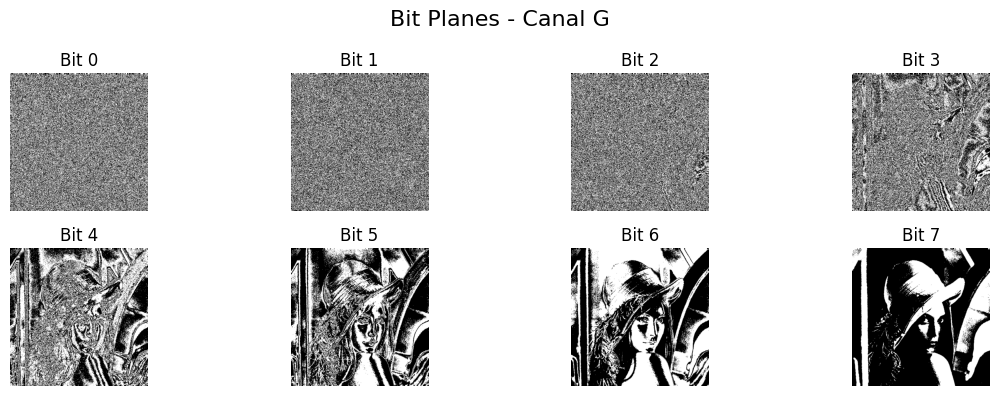

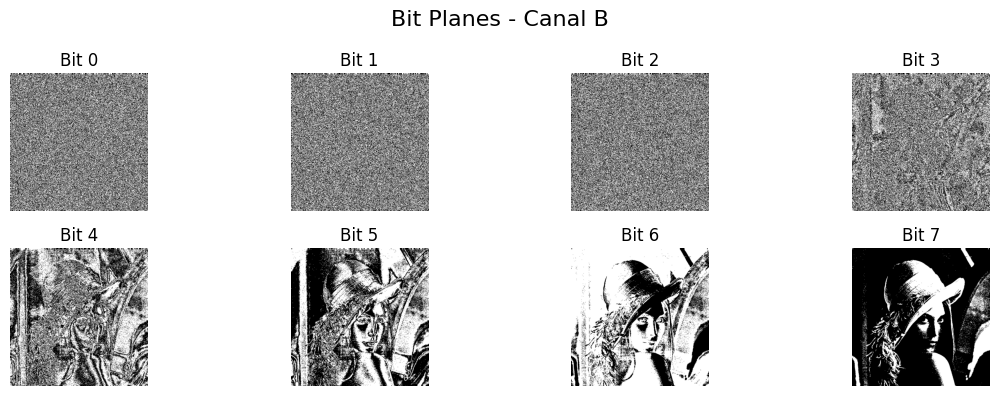

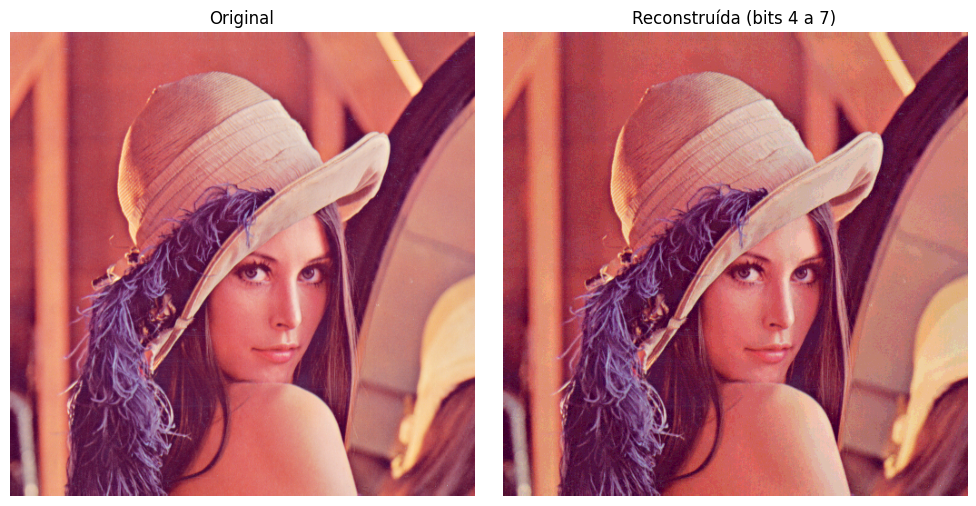

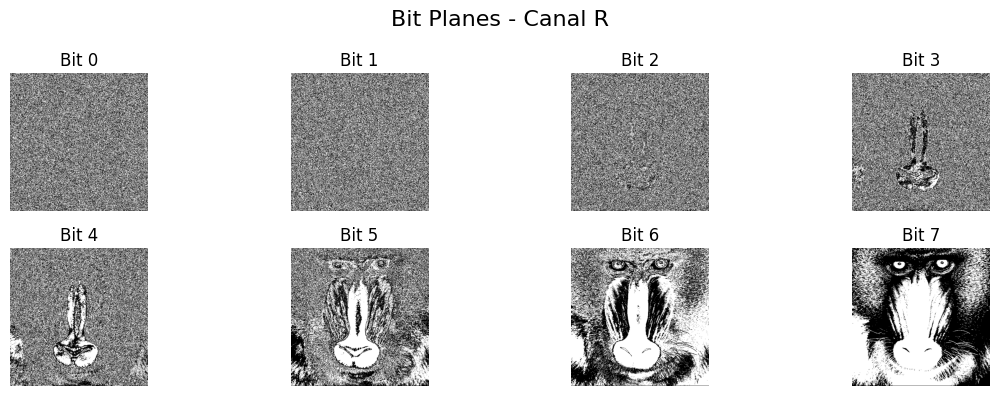

...

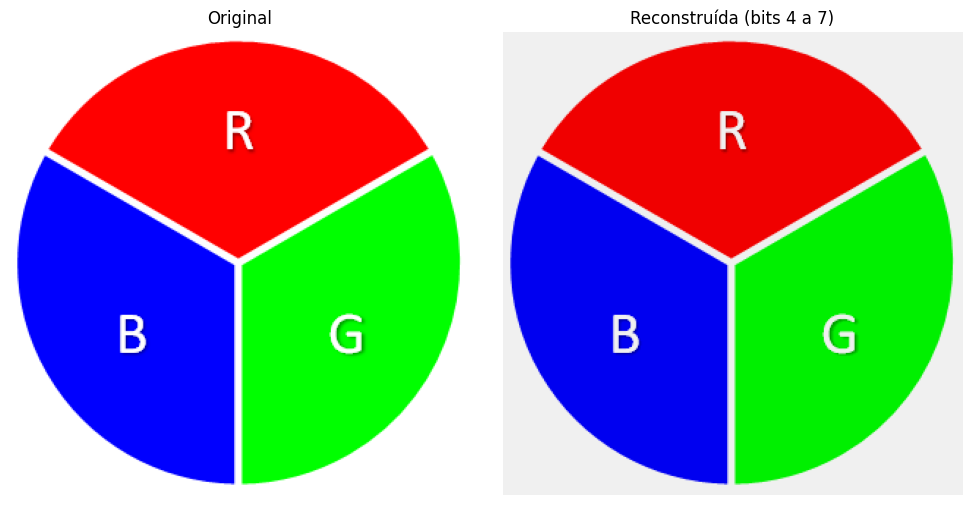

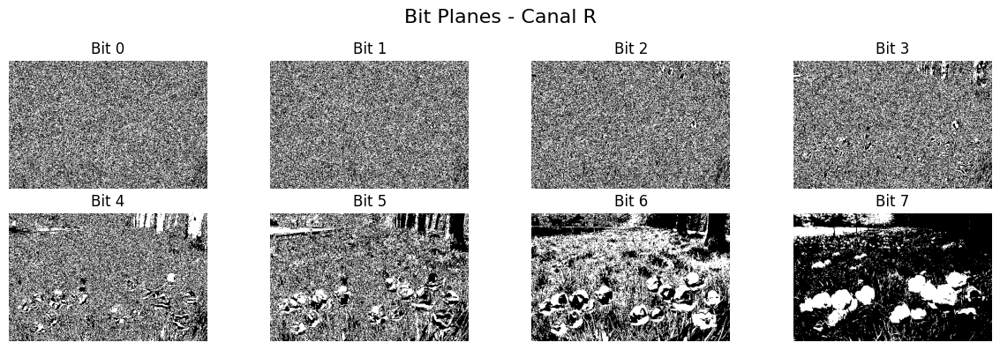

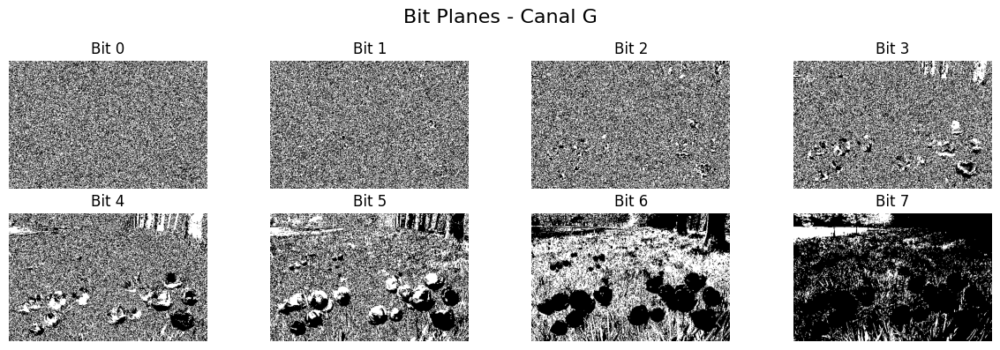

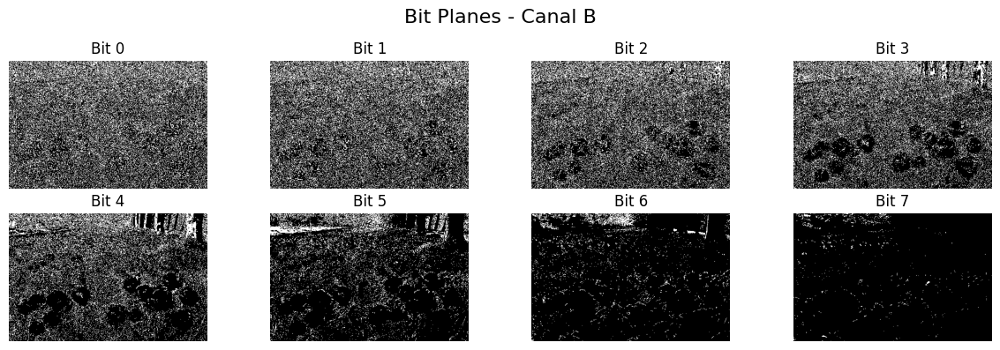

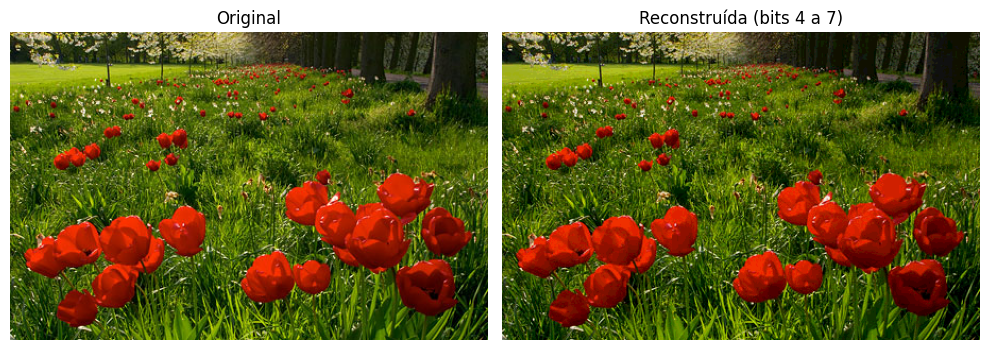

In [38]:
for path in image_paths:
    bit_plane_visualization(path)

* Para cada canal de cor (R, G, B), extraímos os 8 planos de bits individualmente.
* Visualizamos os planos como imagens binárias, onde:
  * Bits 0–3 (LSBs) mostraram ruído ou detalhes muito finos e aleatórios.
  * Bits 4–7 (MSBs) revelaram a maior parte da estrutura da imagem.
* Reconstrução da imagem original usando apenas os bits 4 a 7, somando suas contribuições ponderadas.

### Observações por imagem:
* Lena: A imagem reconstruída manteve boa fidelidade visual. Os MSBs carregam quase toda a informação estrutural.
* Baboon: Apresenta mais detalhes mesmo nos bits menos significativos, mas a reconstrução com MSBs ainda preserva a identidade visual.
* RGB (sintética): Os planos de bits são visivelmente limpos e segmentados. A reconstrução é quase perfeita.
* Flowers: Alta frequência nos bits baixos (ruído dos galhos e folhas). MSBs contêm as formas principais das flores e fundo.

A maior parte da informação visual relevante em imagens RGB está concentrada nos 4 bits mais significativos de cada canal. A técnica de fatiamento de bits permite identificar a importância relativa de cada plano na formação da imagem e pode ser usada em compressão, codificação ou esteganografia.

## 8. Color-based Object Segmentation using HSV Thresholding

Objective: Convert image to HSV, apply thresholding to extract objects of a certain color (e.g., red apples).

Topics: Color segmentation, HSV masking.

Bonus: Use trackbars to adjust thresholds dynamically.

In [39]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display

In [40]:
def segment_color_hsv(image_path, lower_hsv, upper_hsv):
    bgr = cv2.imread(image_path)
    hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)

    mask = cv2.inRange(hsv, lower_hsv, upper_hsv)

    result = cv2.bitwise_and(bgr, bgr, mask=mask)

    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB))
    plt.title("Imagem Original")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(mask, cmap='gray')
    plt.title("Máscara HSV")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
    plt.title("Segmentado (HSV)")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [41]:
lower_red1 = np.array([0, 100, 100])
upper_red1 = np.array([10, 255, 255])

In [42]:
lower_red2 = np.array([160, 100, 100])
upper_red2 = np.array([180, 255, 255])

In [43]:
img_path = "/content/flowers.jpg"
bgr_img = cv2.imread(img_path)
hsv_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2HSV)

In [44]:
bgr = cv2.imread(img_path)
hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
mask1 = cv2.inRange(hsv, lower_red1, upper_red1)
mask2 = cv2.inRange(hsv, lower_red2, upper_red2)
mask = cv2.bitwise_or(mask1, mask2)
result = cv2.bitwise_and(bgr, bgr, mask=mask)

(np.float64(-0.5), np.float64(449.5), np.float64(289.5), np.float64(-0.5))

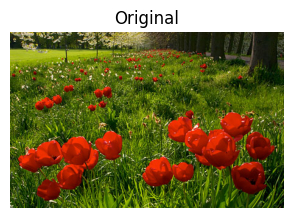

In [45]:
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB))
plt.title("Original")
plt.axis('off')

(np.float64(-0.5), np.float64(449.5), np.float64(289.5), np.float64(-0.5))

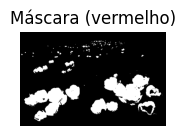

In [46]:
plt.subplot(1, 3, 2)
plt.imshow(mask, cmap='gray')
plt.title("Máscara (vermelho)")
plt.axis('off')

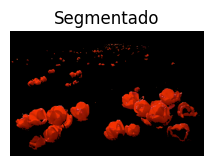

In [47]:
plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
plt.title("Segmentado")
plt.axis('off')
plt.tight_layout()
plt.show()

In [48]:
def update(h_min, s_min, v_min, h_max, s_max, v_max):
    lower = np.array([h_min, s_min, v_min])
    upper = np.array([h_max, s_max, v_max])
    mask = cv2.inRange(hsv_img, lower, upper)
    result = cv2.bitwise_and(bgr_img, bgr_img, mask=mask)

    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB))
    plt.title("Original")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(mask, cmap='gray')
    plt.title("Máscara HSV")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
    plt.title("Segmentado")
    plt.axis('off')
    plt.show()

In [49]:
widgets.interact(
    update,
    h_min=widgets.IntSlider(min=0, max=179, step=1, value=0),
    s_min=widgets.IntSlider(min=0, max=255, step=1, value=100),
    v_min=widgets.IntSlider(min=0, max=255, step=1, value=100),
    h_max=widgets.IntSlider(min=0, max=179, step=1, value=10),
    s_max=widgets.IntSlider(min=0, max=255, step=1, value=255),
    v_max=widgets.IntSlider(min=0, max=255, step=1, value=255)
)

interactive(children=(IntSlider(value=0, description='h_min', max=179), IntSlider(value=100, description='s_mi…

<function __main__.update(h_min, s_min, v_min, h_max, s_max, v_max)>

## 9. Convert and Visualize Images in the NTSC (YIQ) Color Space

Objective: Manually convert an RGB image to NTSC (YIQ) and visualize the Y, I, and Q channels.

Topics: Color space math, visualization.

Note: OpenCV doesn't support YIQ directly, so students can implement the conversion using matrices.

In [50]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [51]:
def rgb_to_yiq(img_rgb):
    transform_matrix = np.array([
        [0.299, 0.587, 0.114],
        [0.596, -0.274, -0.322],
        [0.211, -0.523, 0.312]
    ])
    img_normalized = img_rgb / 255.0
    yiq_img = np.dot(img_normalized, transform_matrix.T)
    return yiq_img

In [52]:
def yiq_to_rgb(yiq_img):
    inverse_matrix = np.array([
        [1.0,  0.956,  0.621],
        [1.0, -0.272, -0.647],
        [1.0, -1.106,  1.703]
    ])
    rgb_img = np.dot(yiq_img, inverse_matrix.T)
    rgb_img = np.clip(rgb_img, 0, 1)
    rgb_img = (rgb_img * 255).astype(np.uint8)
    return rgb_img

In [53]:
image_files = ["lena.png", "baboon.png", "chips.png"]

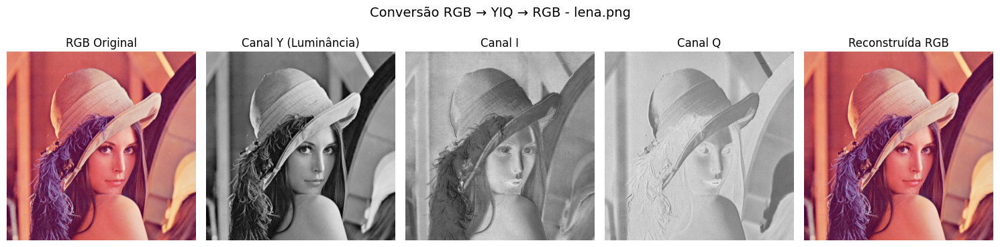

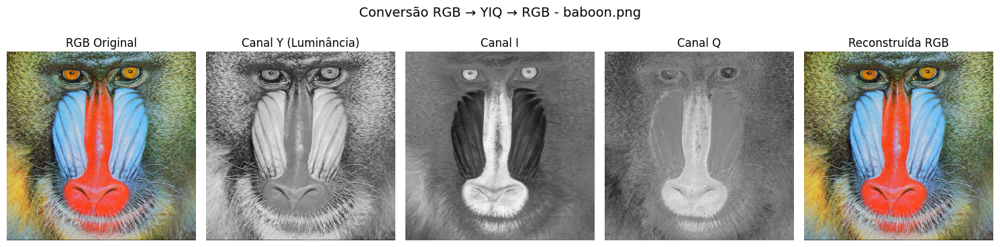

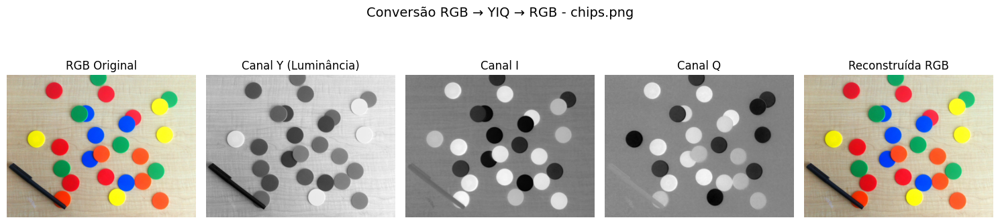

In [54]:
for filename in image_files:
    bgr_img = cv2.imread(filename)
    rgb_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)

    yiq_img = rgb_to_yiq(rgb_img)
    Y = yiq_img[:, :, 0]
    I = yiq_img[:, :, 1]
    Q = yiq_img[:, :, 2]

    rgb_reconstructed = yiq_to_rgb(yiq_img)

    plt.figure(figsize=(15, 4))
    plt.suptitle(f"Conversão RGB → YIQ → RGB - {filename}", fontsize=14)

    plt.subplot(1, 5, 1)
    plt.imshow(rgb_img)
    plt.title("RGB Original")
    plt.axis('off')

    plt.subplot(1, 5, 2)
    plt.imshow(Y, cmap='gray')
    plt.title("Canal Y (Luminância)")
    plt.axis('off')

    plt.subplot(1, 5, 3)
    plt.imshow(I, cmap='gray')
    plt.title("Canal I")
    plt.axis('off')

    plt.subplot(1, 5, 4)
    plt.imshow(Q, cmap='gray')
    plt.title("Canal Q")
    plt.axis('off')

    plt.subplot(1, 5, 5)
    plt.imshow(rgb_reconstructed)
    plt.title("Reconstruída RGB")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

## 10. Color Image Enhancement with Histogram Equalization

Objective: Apply histogram equalization on individual channels in different color spaces (e.g., Y in YCrCb, L in LAB).

Topics: Contrast enhancement, color models.

Discussion: Explain why histogram equalization should not be directly applied to RGB.

In [55]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [56]:
def equalize_ycrcb(img_bgr):
    img_ycrcb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2YCrCb)
    y, cr, cb = cv2.split(img_ycrcb)
    y_eq = cv2.equalizeHist(y)
    img_eq = cv2.merge([y_eq, cr, cb])
    return cv2.cvtColor(img_eq, cv2.COLOR_YCrCb2BGR)

In [57]:
def equalize_lab(img_bgr):
    img_lab = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(img_lab)
    l_eq = cv2.equalizeHist(l)
    img_eq = cv2.merge([l_eq, a, b])
    return cv2.cvtColor(img_eq, cv2.COLOR_LAB2BGR)

In [58]:
image_files = ["lena.png", "baboon.png", "chips.png"]

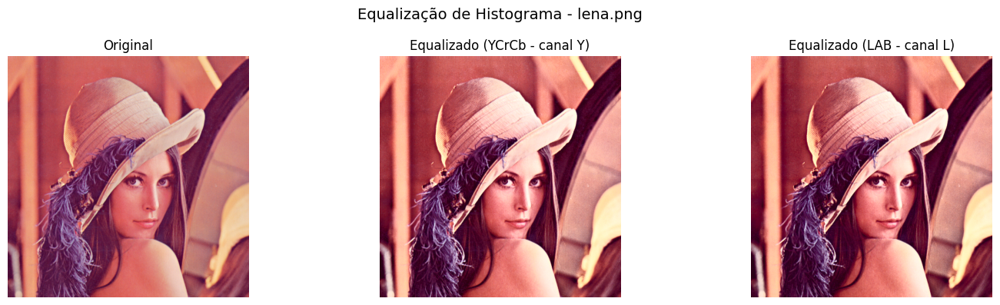

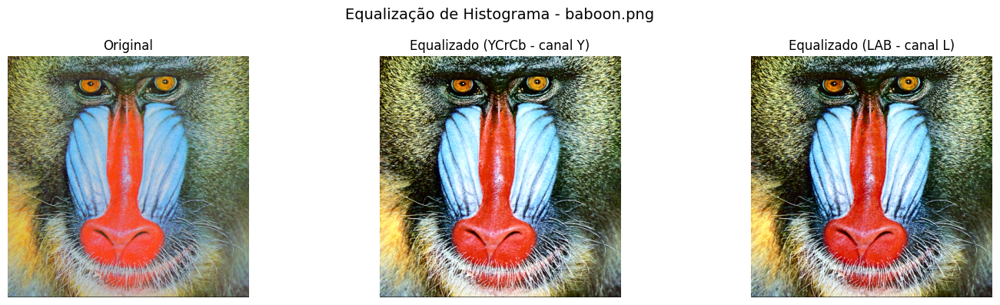

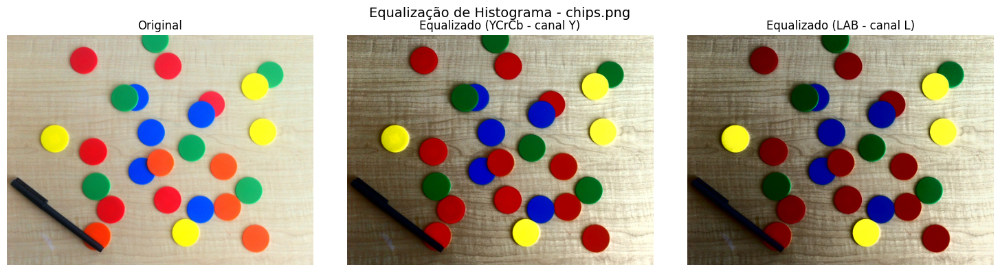

In [59]:
for filename in image_files:
    img_bgr = cv2.imread(filename)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    eq_ycrcb = cv2.cvtColor(equalize_ycrcb(img_bgr), cv2.COLOR_BGR2RGB)
    eq_lab   = cv2.cvtColor(equalize_lab(img_bgr), cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(15, 4))
    plt.suptitle(f"Equalização de Histograma - {filename}", fontsize=14)

    plt.subplot(1, 3, 1)
    plt.imshow(img_rgb)
    plt.title("Original")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(eq_ycrcb)
    plt.title("Equalizado (YCrCb - canal Y)")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(eq_lab)
    plt.title("Equalizado (LAB - canal L)")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

### Por que não aplicar equalização diretamente no RGB?
Aplicar `cv2.equalizeHist()` diretamente em cada canal RGB pode causar:
* Distorções de cor, pois o RGB representa cor + brilho juntos em cada canal.
* A equalização por canal pode mudar drasticamente os tons originais, gerando cores artificiais.

Por isso, é preferível converter para espaços que separam luminância da cor, como:
* YCrCb: separa Y (luminância) de Cr e Cb (crominância).
* LAB: separa L (luminosidade) de a e b (informações de cor).

### Equalização direta no RGB (para fins de comparação)

In [60]:
def equalize_rgb_channels(img_bgr):
    b, g, r = cv2.split(img_bgr)
    b_eq = cv2.equalizeHist(b)
    g_eq = cv2.equalizeHist(g)
    r_eq = cv2.equalizeHist(r)
    eq_img_bgr = cv2.merge([b_eq, g_eq, r_eq])
    return eq_img_bgr

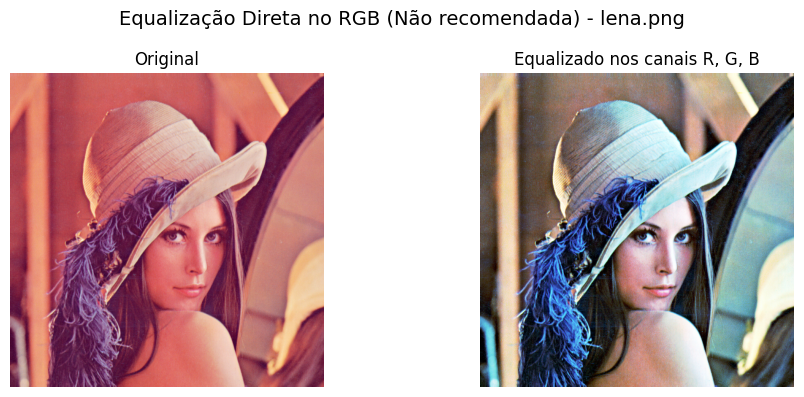

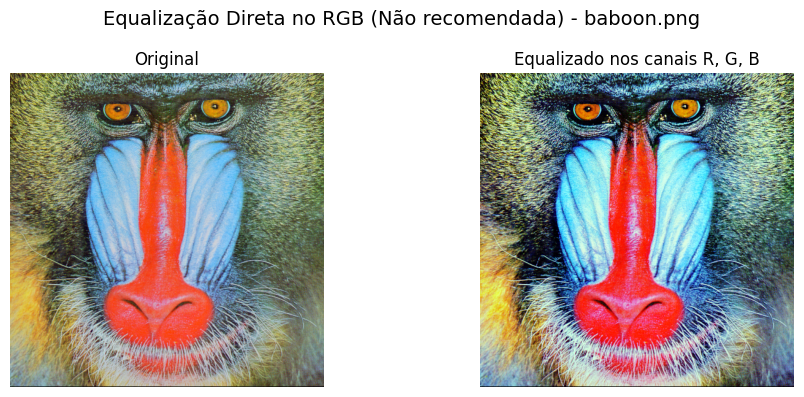

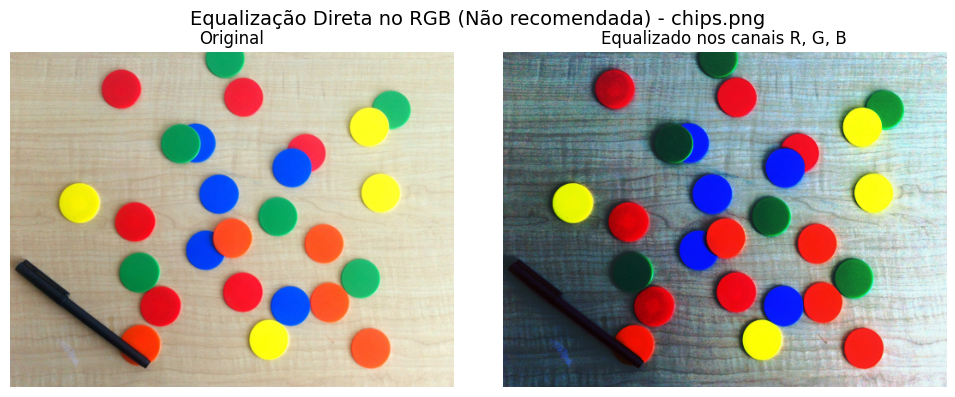

In [61]:
for filename in image_files:
    img_bgr = cv2.imread(filename)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    eq_rgb_bgr = equalize_rgb_channels(img_bgr)
    eq_rgb = cv2.cvtColor(eq_rgb_bgr, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 4))
    plt.suptitle(f"Equalização Direta no RGB (Não recomendada) - {filename}", fontsize=14)

    plt.subplot(1, 2, 1)
    plt.imshow(img_rgb)
    plt.title("Original")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(eq_rgb)
    plt.title("Equalizado nos canais R, G, B")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

### Por que isso não é recomendável?
A equalização direta nos canais R, G, B independentemente altera o equilíbrio de cores, resultando em imagens com tons artificiais ou incoerentes.

Exemplo de efeitos colaterais:
* Céus azuis podem ficar com tons esverdeados ou violáceos.
* Peles humanas ficam amareladas ou azuladas.
* Objetos com cor sólida sofrem desbalanço cromático.